# Importing required libs

In [1]:
import tensorflow as tf
import time
# Check TensorFlow version
print(f"TensorFlow version: {tf.__version__}")

# List available physical devices
physical_devices = tf.config.list_physical_devices('GPU')
print("Available GPUs:")
for device in physical_devices:
    print(device)
    
# Check if TensorFlow is using the GPU
if tf.test.is_built_with_cuda():
    print("TensorFlow is built with CUDA")
    if len(physical_devices) > 0:
        print("TensorFlow is using the GPU")
    else:
        print("TensorFlow is not using the GPU, but it is available")
else:
    print("TensorFlow is not built with CUDA")


TensorFlow version: 2.6.0
Available GPUs:
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
TensorFlow is built with CUDA
TensorFlow is using the GPU


In [2]:
%run generator.ipynb
%run model.ipynb

In [26]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate
from tensorflow.keras.callbacks import ModelCheckpoint,Callback,LearningRateScheduler , TensorBoard
from tensorflow import keras
from tensorflow.keras.optimizers import SGD, RMSprop
from tensorflow.keras import backend as K
import os
import datetime
import numpy as np
import shutil
# from skimage import morphology, feature, segmentation, measure, io, color
# from skimage.filters import sobel
import matplotlib.pyplot as plt
import cv2
import pdb
import imageio
from scipy import misc
import scipy.ndimage as ndimage
import warnings
warnings.filterwarnings('ignore')
# from google.colab.patches import cv2_imshow  # Only required in Google Colab


# Visualization methods

In [ ]:
def to_three_channels(img):
  return np.squeeze(np.stack((img,img,img), 2))

def show_sample(img, anno, label):
  squeezed =  np.squeeze(anno)

  figure, axis = plt.subplots(1,3)
  axis[0].imshow(img)
  axis[1].imshow(squeezed)
  squeezed =  np.squeeze(label)
  axis[2].imshow(squeezed)




def show_batch(img, label):
  show_sample(img[0,:,:,:],label[0,:,:,:])

In [144]:
import os
import numpy as np
import matplotlib.pyplot as plt

def save_sample(img, label , gt,  folder_name , sample_file_name, lable_type , counts):
    folder_name = folder_name + str(sample_file_name).split("dic.png")[0] + "/"
    if not os.path.exists(folder_name):
        os.makedirs(folder_name)
        print(folder_name)
        output_path = os.path.join(folder_name, 'counts.txt')
        with open(output_path, 'w') as file:
            file.write(str(counts) + '\n')
    
    
    squeezed_label =  np.squeeze(label)
    squeezed_gt =  np.squeeze(gt)
    

    # Ensure images are in the correct range
    if img.dtype == np.float64 or img.dtype == np.float32:
        img = np.interp(img, (img.min(), img.max()), (0, 1))
    
    if squeezed_label.dtype == np.float64 or squeezed_label.dtype == np.float32:
        squeezed_label = np.interp(squeezed_label, (squeezed_label.min(), squeezed_label.max()), (0, 1))
    if squeezed_gt.dtype == np.float64 or squeezed_gt.dtype == np.float32:
        squeezed_gt = np.interp(squeezed_gt, (squeezed_gt.min(), squeezed_gt.max()), (0, 1))
    

    # Save the first image
    fig, ax = plt.subplots()
    ax.imshow(img)
    # ax.set_title('Image')
    plt.axis('off')  # Turn off the axis
    output_path = os.path.join(folder_name, 'image_1.jpg')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)  # Save without white spaces
    plt.close(fig)  # Close the figure to free up memory
    
    
    # Save the third image
    fig, ax = plt.subplots()
    ax.imshow(squeezed_label)
    # ax.set_title('Squeezed Label')
    plt.axis('off')  # Turn off the axis
    output_path = os.path.join(folder_name, 'image_pr_'+lable_type+'.jpg')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)  # Save without white spaces
    plt.close(fig)  # Close the figure to free up memory

     # Save the third image
    fig, ax = plt.subplots()
    ax.imshow(squeezed_gt)
    # ax.set_title('Squeezed gt')
    plt.axis('off')  # Turn off the axis
    output_path = os.path.join(folder_name, 'image_gt_'+lable_type+'.jpg')
    plt.savefig(output_path, bbox_inches='tight', pad_inches=0)  # Save without white spaces
    plt.close(fig)  # Close the figure to free up memory
    # plt.show()


def show_save_all_sample(img , c_label , c_gt , r_label , r_gt , folder_name , sample_file_name , counts ):
    
    squeezed_r_label = np.squeeze(r_label)
    squeezed_c_label = np.squeeze(c_label)
    # Ensure images are in the correct range
    if img.dtype == np.float64 or img.dtype == np.float32:
        img = np.interp(img, (img.min(), img.max()), (0, 1))
   
    if squeezed_c_label.dtype == np.float64 or squeezed_c_label.dtype == np.float32:
        squeezed_c_label = np.interp(squeezed_c_label, (squeezed_c_label.min(), squeezed_c_label.max()), (0, 1))

    
    if squeezed_r_label.dtype == np.float64 or squeezed_c_label.dtype == np.float32:
        squeezed_r_label = np.interp(squeezed_r_label, (squeezed_r_label.min(), squeezed_r_label.max()), (0, 1))
        
   
    figure, axis = plt.subplots(1, 5, figsize=(15, 5))
    axis[0].imshow(img)
    axis[0].set_title('Image')
    axis[0].axis('off')
    
  
    axis[1].imshow(c_gt)
    axis[1].set_title('Centroids Ground Truth')
    axis[1].axis('off')
    
    axis[2].imshow(squeezed_c_label)
    axis[2].set_title('Centroids Prediction')
    axis[2].axis('off')

    
                 
    axis[3].imshow(r_gt)
    axis[3].set_title('Regions Ground Truth')
    axis[3].axis('off')
    
    axis[4].imshow(squeezed_r_label)
    axis[4].set_title('Regions Prediction')
    axis[4].axis('off')

    plt.show()
    save_sample(img, c_label ,c_gt, folder_name , sample_file_name, "centroids" , counts)
    save_sample(img, r_label ,r_gt, folder_name , sample_file_name, "regions" , counts )
    



# preparing the dataset

In [5]:
# Setting dimensions
image_height = 256
image_width = 256

## Generating DIC like images

In [23]:
base_address= 'C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper'

In [24]:
folder_path = base_address +'/real_dataset/data_80_cells/'
output_folder_path = base_address+'/real_dataset/data_80_dics/'

files = os.listdir(folder_path)

for file in files:
    # Create the full file path
    print(os.path.join(folder_path, file))
    if 'ipynb_checkpoints' not in os.path.join(folder_path, file) :

        file_path = os.path.join(folder_path, file)
        # Load the input image
        input_image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
    
        # Apply gradient filter to find edges of the cells
        gradient_x = cv2.Sobel(input_image, cv2.CV_64F, 1, 0, ksize=3)
        gradient_y = cv2.Sobel(input_image, cv2.CV_64F, 0, 1, ksize=3)
        gradient_magnitude = cv2.magnitude(gradient_x, gradient_y)
    
        # Normalize gradient magnitude to [0, 255]
        gradient_magnitude = cv2.normalize(gradient_magnitude, None, 0, 255, cv2.NORM_MINMAX)
    
        # Simulate shading
        shading_strength = 0.5 # Adjust this parameter to control shading strength
        shading = np.ones_like(input_image, dtype=np.float64) * 127
        shading += shading_strength * gradient_magnitude
    
        # Add shading to the input image
        output_image = cv2.add(input_image, shading.astype(np.uint8))
    
        new_file_name = file.replace('cell.png', '_dic.png')
    
        output_file_path = os.path.join(output_folder_path, new_file_name)
        print(output_file_path)
        cv2.imwrite(output_file_path, output_image)

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_cells/.ipynb_checkpoints
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_cells/001cell.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_dics/001_dic.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_cells/002cell.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_dics/002_dic.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_cells/003cell.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_dics/003_dic.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_cells/004cell.png
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/real_dataset/data_80_dics/004_dic.png
C:/User

## Generating regions images

In [30]:
centroids_path = base_address+ './real_dataset/data_80_dots/'
regions_path =base_address+'./real_dataset/data_80_regions/'

data = []
anno = []
img_labels=[]
def show_maped_centroids(centroids_path):
  imList = os.listdir(centroids_path)
  for i in range(len(imList)):
          # read the original image
          binary_image = cv2.imread( os.path.join(centroids_path, imList[i]) , cv2.IMREAD_GRAYSCALE)
          print(binary_image.shape)
          black_image = np.zeros((image_height, image_width, 1), dtype=np.uint8)

          white_pixel_locations = np.where(binary_image >0)

          for y, x in zip(*white_pixel_locations):
              cv2.circle(black_image, (x, y), 7 , 255, -1)  # Draw a red circle at each white pixel location
              cv2.circle(binary_image, (x, y), 7 , 255, -1)  # Draw a red circle at each white pixel location

          # Show the result image
          # cv2_imshow(black_image)
          # cv2_imshow(binary_image)
          cv2.imwrite( str(regions_path+ str( imList[i][:3] )+ 'regions.png')  , black_image )

          print(str(os.path.join(centroids_path, imList[i][:3])) , "\n\n\n"  )
show_maped_centroids(centroids_path)

(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/001 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/002 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/003 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/004 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/005 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/006 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/007 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper./real_dataset/data_80_dots/008 



(256, 256)
C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_

# Light-U-Net Centroids

In [92]:
def step_decay(epoch):
    step = 16
    lrate=1e0
    num =  epoch // step
    if num % 3 == 0:
        lrate = 1e-3
    elif num % 3 == 1:
        lrate = 1e-4
    else:
        lrate = 1e-5
        #lrate = initial_lrate * 1/(1 + decay * (epoch - num * step))
    print('Learning rate for epoch {} is {}.'.format(epoch+1, lrate))
    return float(lrate)

class LossHistory(Callback):
    def on_train_begin(self, logs={}):
        self.losses = []

    def on_batch_end(self, batch, logs={}):
        self.losses.append(logs.get('loss'))

tf.config.run_functions_eagerly(True)
np.float = float

def train_(data, anno):
    # # data, anno = read_data(base_path)
    # data, anno = load_images_from_folder(input_image_folder , label_center_folder , "region")
    # print(f'Loaded {len(data)} cell images and  {len(anno)} regions label images.')

    file_name=  datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    # anno = np.expand_dims(anno, axis = 1)

    mean = np.mean(data)
    std = np.std(data)

    data_ = (data - mean) / std
    Length = int(len(data)*0.85)
    print("train set size : ",Length , " test set size : " , len(data) - Length)

    train_data = data_[:Length, :]
    train_anno = anno[:Length, :]
    val_data = data_[Length:, :]
    val_anno = anno[Length:, :]

    print('-'*30)
    print('Creating and compiling the fully convolutional regression networks.')
    print('-'*30)

    model = buildModel_Light_U_net(input_dim = (256,256,3))
    model_checkpoint = ModelCheckpoint(base_address+'/checkpoints/Light_U_Net_center'+file_name+'.hdf5', monitor='loss', save_best_only=True)
    model.summary()
    print('...Fitting model...')
    print('-'*30)
    change_lr = LearningRateScheduler(step_decay)

    datagen = ImageDataGenerator(
        featurewise_center = False,  # set input mean to 0 over the dataset
        samplewise_center = False,  # set each sample mean to 0
        featurewise_std_normalization = False,  # divide inputs by std of the dataset
        samplewise_std_normalization = False,  # divide each input by its std
        zca_whitening = False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        width_shift_range = 0.3,  # randomly shift images horizontally (fraction of total width)
        height_shift_range = 0.3,  # randomly shift images vertically (fraction of total height)
        zoom_range = 0.3,
        shear_range = 0.,
        horizontal_flip = True,  # randomly flip images
        vertical_flip = True, # randomly flip images
        fill_mode = 'constant',
        dim_ordering = 'tf')

    # Fit the model on the batches generated by datagen.flow().
    history = model.fit_generator(datagen.flow(train_data,
                                      train_anno,
                                      batch_size = 16
                                      ),
                        steps_per_epoch = train_data.shape[0],
                        epochs = 50,
                        #epochs = 192,
                        callbacks = [model_checkpoint, change_lr],
                        )
    return history , model, val_data, val_anno
    """ model.load_weights('cell_counting.hdf5')
    A = model.predict(val_data)
    mean_diff = np.average(np.abs(np.sum(np.sum(A,1),1)-np.sum(np.sum(val_anno,1),1))) / (100.0)
    print('After training, the difference is : {} cells per image.'.format(np.abs(mean_diff))) """


    


# Centroids

In [120]:
input_image_folder= base_address+ '/real_dataset/data_80_dics/'

label_center_folder= base_address+ '/real_dataset/data_80_dots/'

In [163]:

def load_images_from_folder(input_image_folder , label_image_folder , type_of_label , factor= 100):
    images = []
    labels = []
    dots_count=[]
    file_names=[]
    for filename in os.listdir(input_image_folder):
        img_path = os.path.join(input_image_folder, filename)
        label_path = os.path.join(label_image_folder, filename[:-8] + 'dots.png')

        # print("input", img_path)
        # print("lable", label_path)
        file_names.append(filename)
        img = cv2.imread(img_path)  # Read as grayscale
        label_image = cv2.imread( label_path )
        # plt.imshow(label_image)
        # plt.axis('off')  # Turn off axis numbers and ticks
        # plt.show()        
        label_image1= label_image
        if type_of_label== 'center':
          label_image= factor * (label_image[:,:,2] > 0)
        label_image = np.expand_dims(label_image, axis=-1)
        # print(label_image.shape)  # Output: (256, 256, 1)
        # print(np.unique(label_image))
        dots_count.append(str(np.sum(label_image1[:,:,2] > 0)))

        if img is not None and label_image is not None :
            # print(img.shape , np.unique(label_image) )
            images.append(img)
            labels.append(label_image)
    return np.array(images), np.array(labels) , np.array(dots_count) , np.array(file_names)

In [124]:
data, anno_centroids , counts , centroids_file_names = load_images_from_folder(input_image_folder , label_center_folder , "center")
print(f'Loaded {len(data)} cell images and  {len(anno_centroids)} regions label images.')

Loaded 80 cell images and  80 regions label images.


## train

In [95]:
history_center , model_center, val_data_center, val_anno_center = train_(data, anno_centroids)

train set size :  68  test set size :  12
------------------------------
Creating and compiling the fully convolutional regression networks.
------------------------------
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 1728        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 256, 256, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activatio

## loss chart

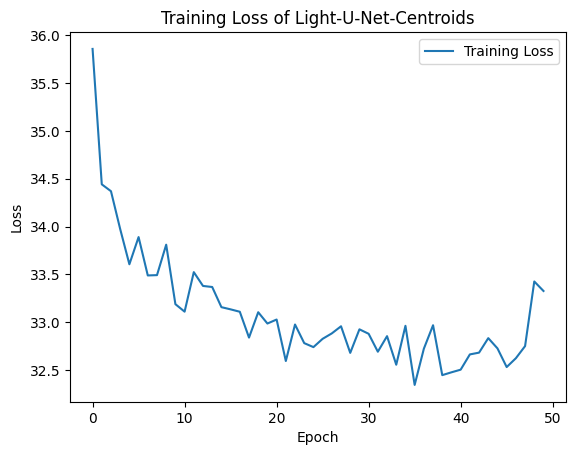

In [137]:
import matplotlib.pyplot as plt

plt.plot(history_center.history['loss'], label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss of Light-U-Net-Centroids')
plt.legend()
plt.show()

# Light-U-Net Regions

In [107]:
def step_decay(epoch):
    step = 16
    lrate=1e0
    num =  epoch // step
    if num % 3 == 0:
        lrate = 1e-3
    elif num % 3 == 1:
        lrate = 1e-4
    else:
        lrate = 1e-5
        #lrate = initial_lrate * 1/(1 + decay * (epoch - num * step))
    print('Learning rate for epoch {} is {}.'.format(epoch+1, lrate))
    return float(lrate)

class LossHistory(Callback):
    def on_train_begin(self, logs={}):
        self.losses = []

    def on_batch_end(self, batch, logs={}):
        self.losses.append(logs.get('loss'))

tf.config.run_functions_eagerly(True)
np.float = float

def train_(data, anno):
    # # data, anno = read_data(base_path)
    # data, anno = load_images_from_folder(input_image_folder , label_center_folder , "region")
    # print(f'Loaded {len(data)} cell images and  {len(anno)} regions label images.')

    file_name=  datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    # anno = np.expand_dims(anno, axis = 1)

    mean = np.mean(data)
    std = np.std(data)

    data_ = (data - mean) / std
    Length = int(len(data)*0.85)
    print("train set size : ",Length , " test set size : " , len(data) - Length)

    train_data = data_[:Length, :]
    train_anno = anno[:Length, :]
    val_data = data_[Length:, :]
    val_anno = anno[Length:, :]

    print('-'*30)
    print('Creating and compiling the fully convolutional regression networks.')
    print('-'*30)

    model = buildModel_Light_U_net(input_dim = (256,256,3))
    model_checkpoint = ModelCheckpoint(base_address+'/checkpoints/Light_U_Net_regions'+file_name+'.hdf5', monitor='loss', save_best_only=True)
    model.summary()
    print('...Fitting model...')
    print('-'*30)
    change_lr = LearningRateScheduler(step_decay)

    datagen = ImageDataGenerator(
        featurewise_center = False,  # set input mean to 0 over the dataset
        samplewise_center = False,  # set each sample mean to 0
        featurewise_std_normalization = False,  # divide inputs by std of the dataset
        samplewise_std_normalization = False,  # divide each input by its std
        zca_whitening = False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        width_shift_range = 0.3,  # randomly shift images horizontally (fraction of total width)
        height_shift_range = 0.3,  # randomly shift images vertically (fraction of total height)
        zoom_range = 0.3,
        shear_range = 0.,
        horizontal_flip = True,  # randomly flip images
        vertical_flip = True, # randomly flip images
        fill_mode = 'constant',
        dim_ordering = 'tf')

    # Fit the model on the batches generated by datagen.flow().
    history = model.fit_generator(datagen.flow(train_data,
                                      train_anno,
                                      batch_size = 16
                                      ),
                        steps_per_epoch = train_data.shape[0],
                        epochs = 50,
                        #epochs = 192,
                        callbacks = [model_checkpoint, change_lr],
                        )
    return history , model, val_data, val_anno
    """ model.load_weights('cell_counting.hdf5')
    A = model.predict(val_data)
    mean_diff = np.average(np.abs(np.sum(np.sum(A,1),1)-np.sum(np.sum(val_anno,1),1))) / (100.0)
    print('After training, the difference is : {} cells per image.'.format(np.abs(mean_diff))) """


    


# Regions

In [155]:

def load_images_from_folder(input_image_folder , label_image_folder , type_of_label , factor= 100):
    images = []
    labels = []
    file_names=[]
    for filename in os.listdir(input_image_folder):

        img_path = os.path.join(input_image_folder, filename)
        label_path = os.path.join(label_image_folder, filename[:-8] + 'regions.png')
        # print(img_path)
        # print(label_path)
        img = cv2.imread(img_path)  # Read as grayscale
        label_image = cv2.imread( label_path )
        # plt.imshow(label_image)
        # plt.axis('off')  # Turn off axis numbers and ticks
        # plt.show()
        if type_of_label== 'center':
          label_image= factor * (label_image[:,:,2] > 0)
        
        label_image = label_image[:,:,0]
        label_image = np.expand_dims(label_image, axis=-1)
        # print(label_image.shape)  # Output: (256, 256, 1)
        # print(np.unique(label_image))

        if img is not None and label_image is not None :
            # print(img.shape )
            # print(img.shape , label_image)
            images.append(img)
            labels.append(label_image)
            file_names.append(filename)

    return np.array(images), np.array(labels) , np.array(file_names)


In [132]:
input_image_folder=base_address+ '/real_dataset/data_80_dics/'

label_region_folder=base_address+ '/real_dataset/data_80_regions/'

In [133]:
data, anno_regions  ,region_file_names = load_images_from_folder(input_image_folder , label_region_folder , "region")
print(f'Loaded {len(data)} cell images and  {len(anno_regions)} regions label images.')


Loaded 80 cell images and  80 regions label images.


## train

In [109]:
history_regions , model_regions, val_data_regions, val_anno_regions = train_(data, anno_regions)

train set size :  68  test set size :  12
------------------------------
Creating and compiling the fully convolutional regression networks.
------------------------------
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_13 (Conv2D)              (None, 256, 256, 64) 1728        input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_13 (BatchNo (None, 256, 256, 64) 256         conv2d_13[0][0]                  
__________________________________________________________________________________________________
activation_13 (Acti

## loss chart

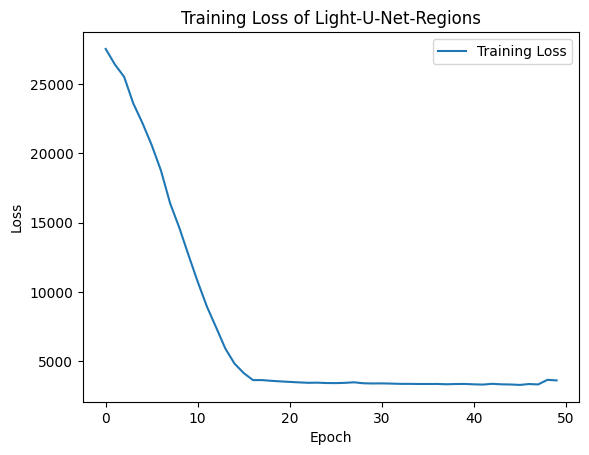

In [136]:
import matplotlib.pyplot as plt

plt.plot(history_regions.history['loss'], label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss of Light-U-Net-Regions')
plt.legend()
plt.show()

#  visualize network outputs

In [138]:
mean = np.mean(data)
std = np.std(data)

data_ = (data - mean) / std
Length = int(len(data)*0.85)
print("train set size : ",Length , " test set size : " , len(data) - Length)

# train_data_center = data_[:Length, :]
# train_anno_center = anno[:Length, :]
# val_data_center = data_[Length:, :]
# val_anno_center = anno[Length:, :]

train set size :  68  test set size :  12


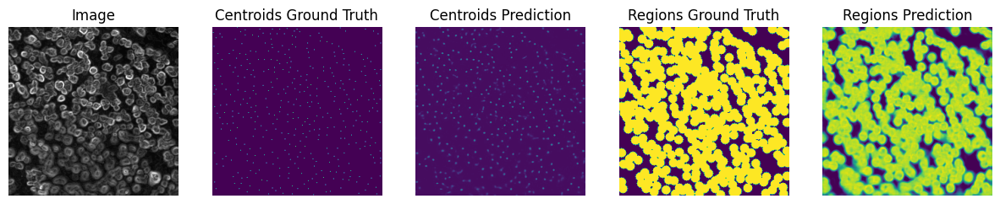

sample  0  saved


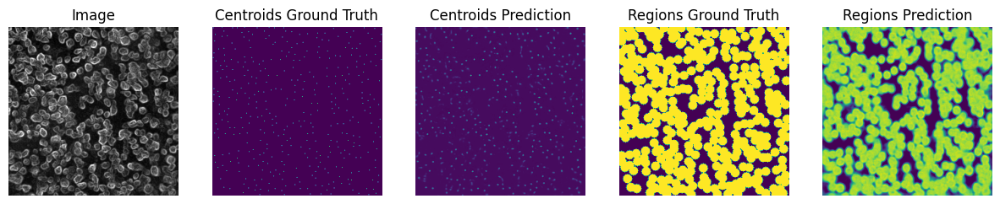

sample  1  saved


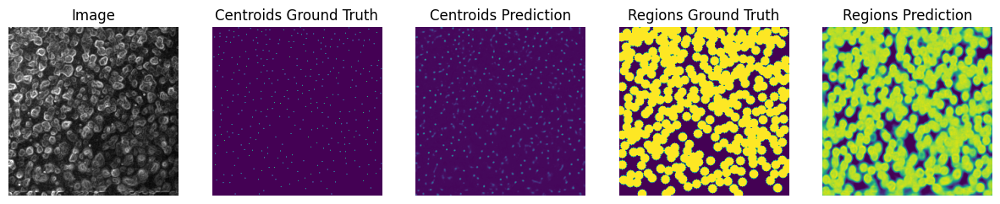

sample  2  saved


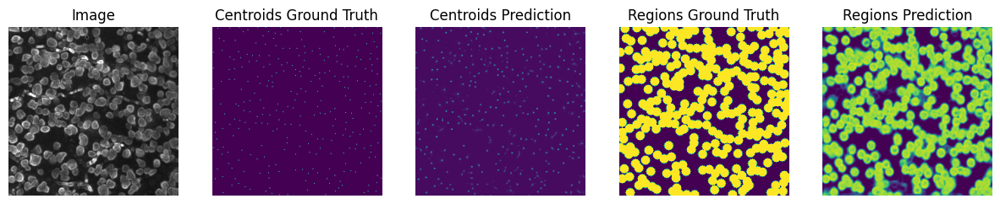

sample  3  saved


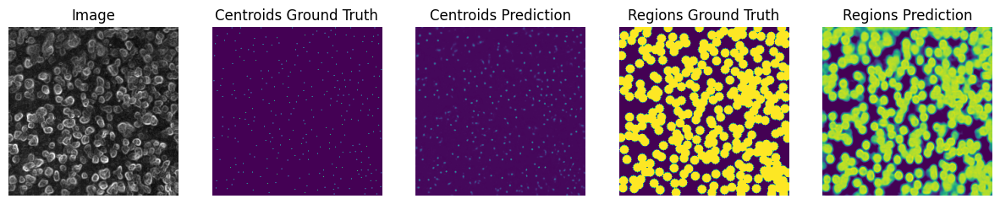

sample  4  saved


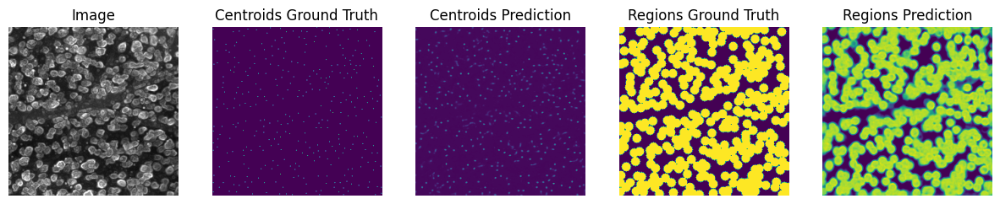

sample  5  saved


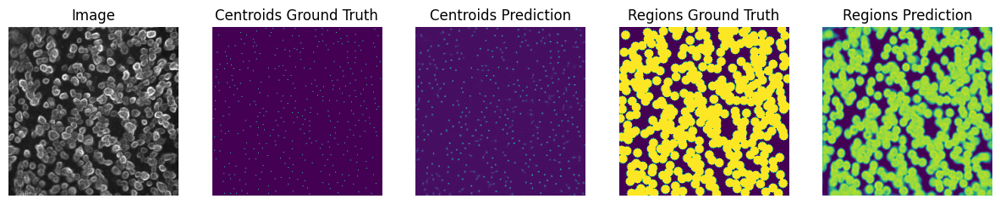

sample  6  saved


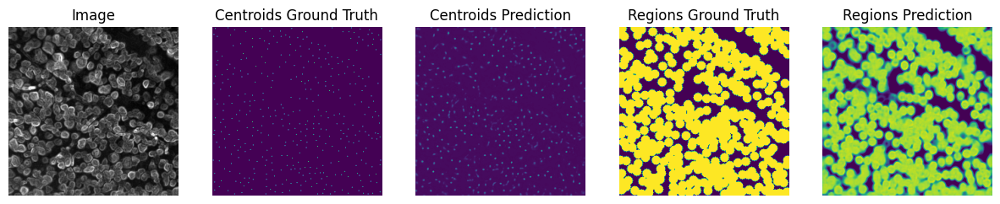

sample  7  saved


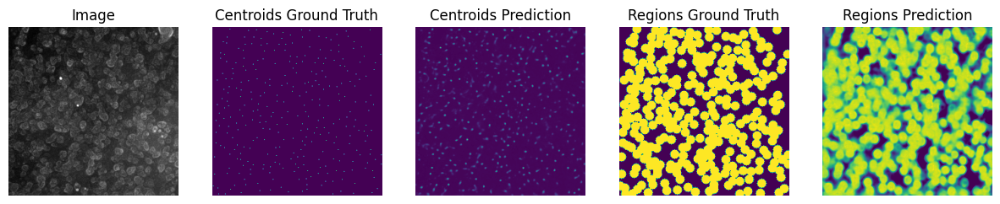

sample  8  saved


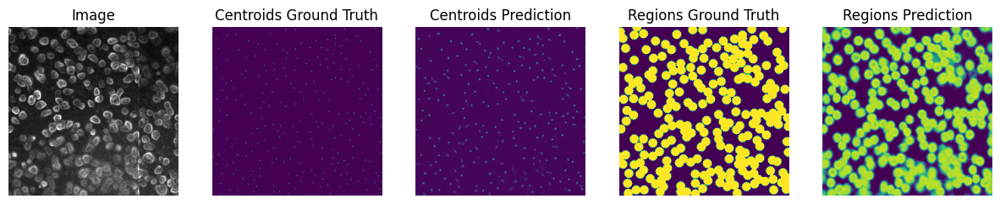

sample  9  saved


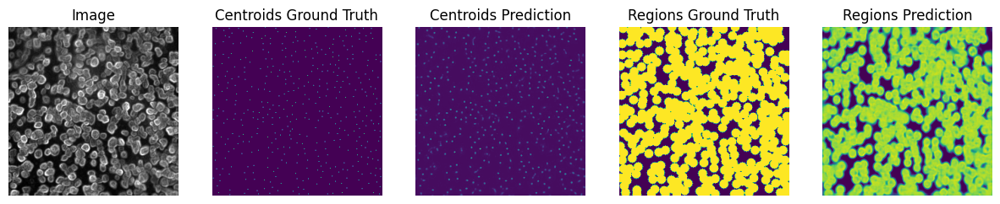

sample  10  saved


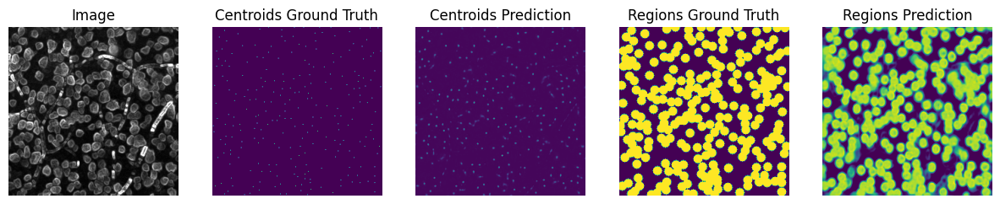

sample  11  saved


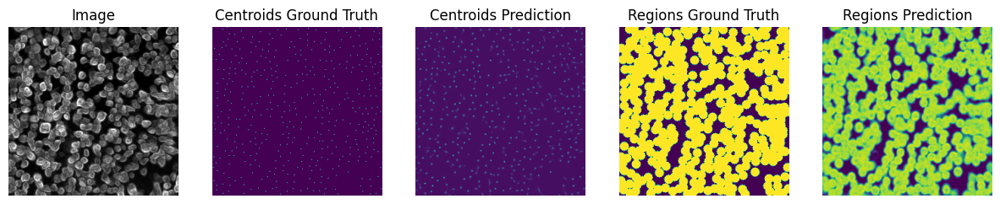

sample  12  saved


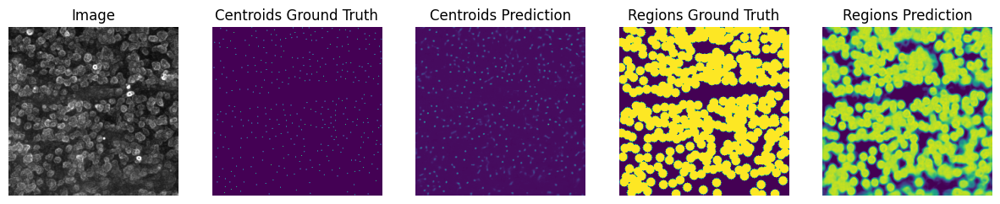

sample  13  saved


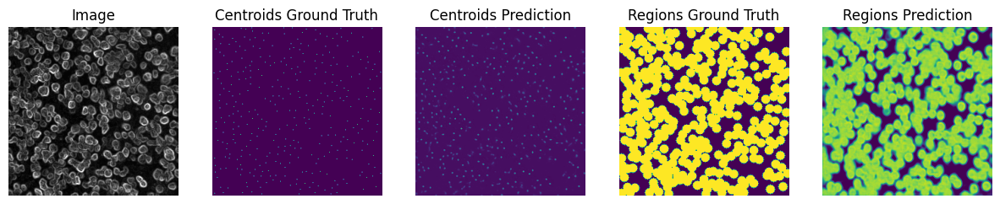

sample  14  saved


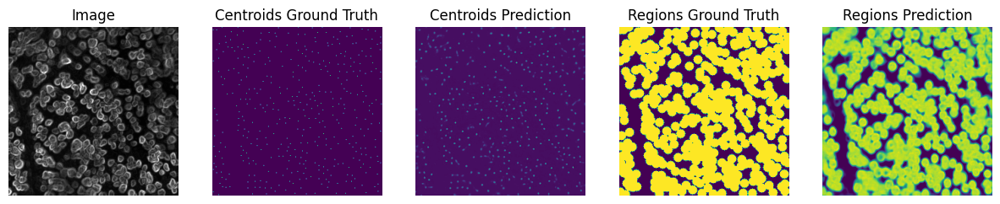

sample  15  saved


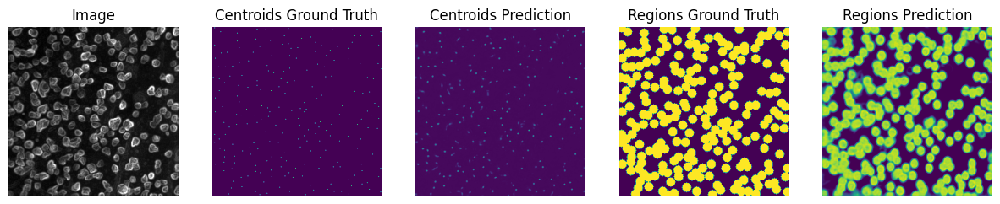

sample  16  saved


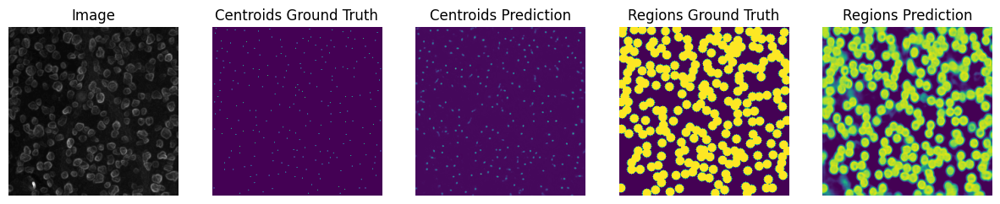

sample  17  saved


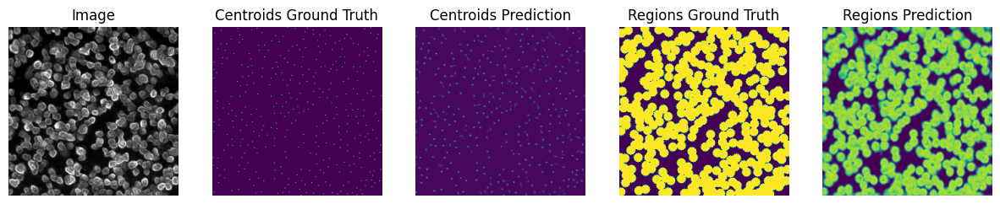

sample  18  saved


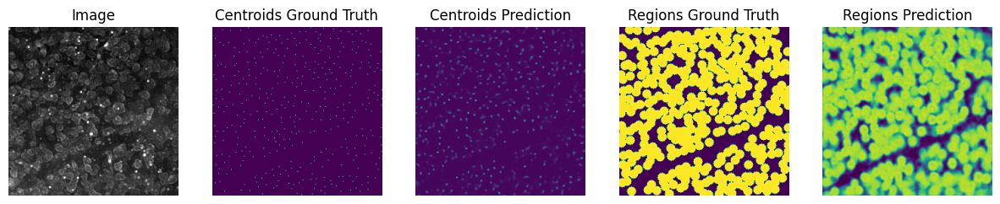

sample  19  saved


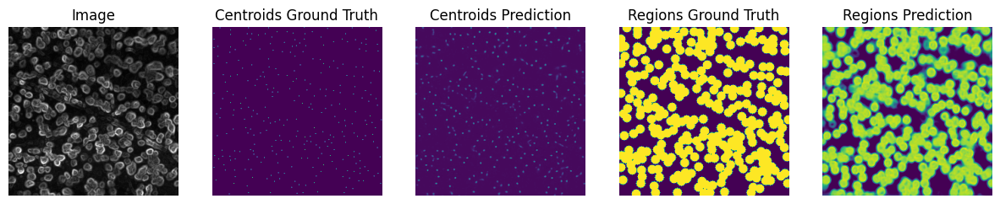

sample  20  saved


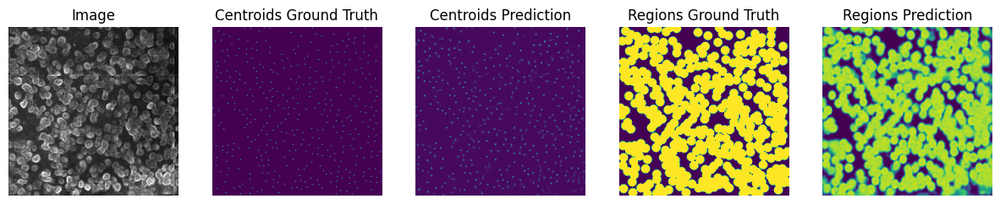

sample  21  saved


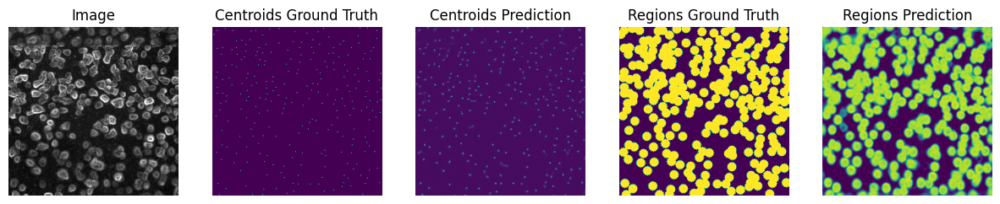

sample  22  saved


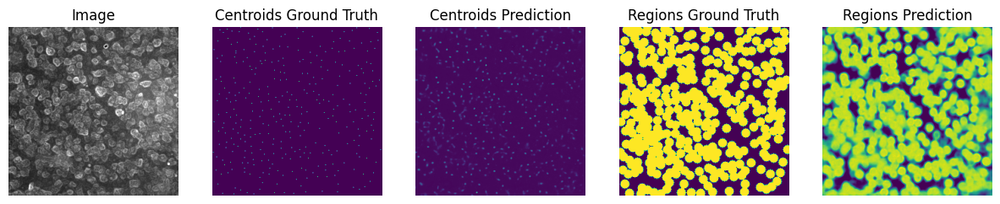

sample  23  saved


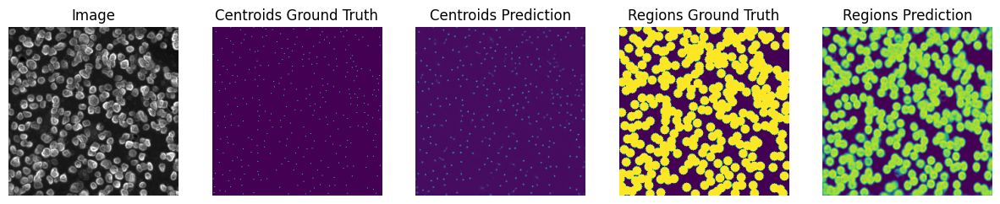

sample  24  saved


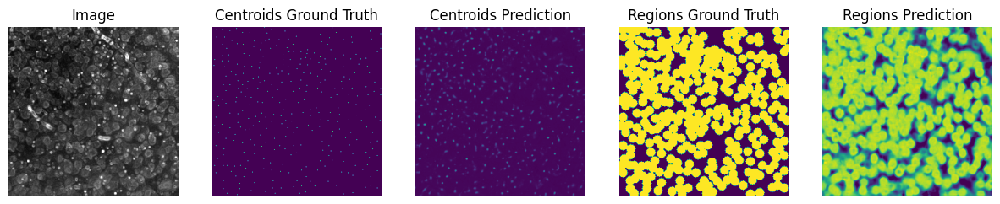

sample  25  saved


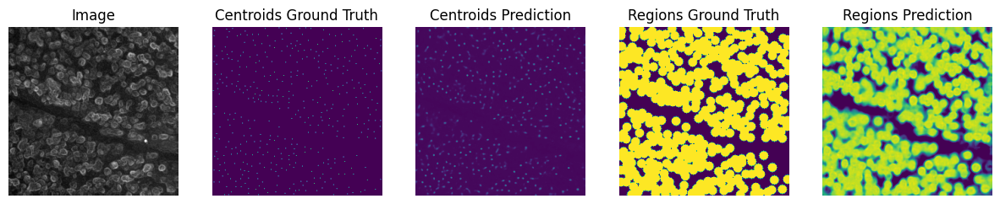

sample  26  saved


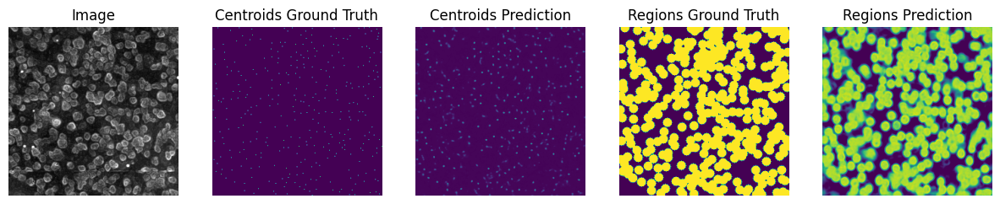

sample  27  saved


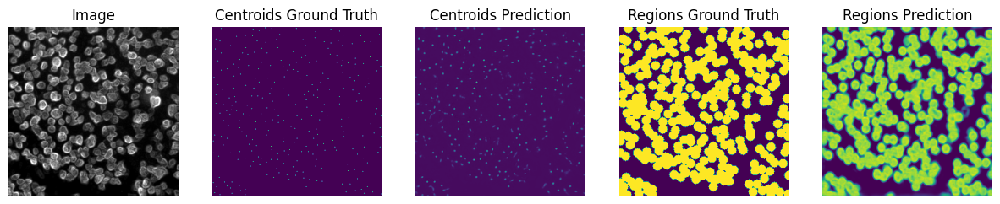

sample  28  saved


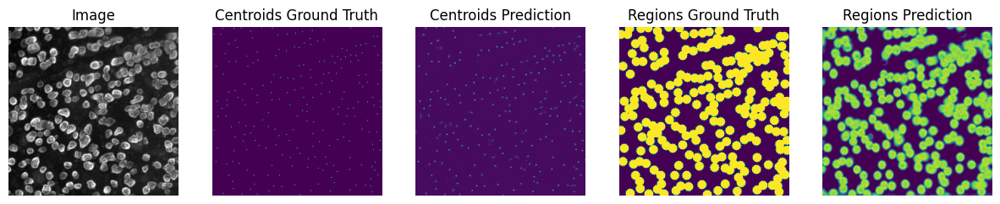

sample  29  saved


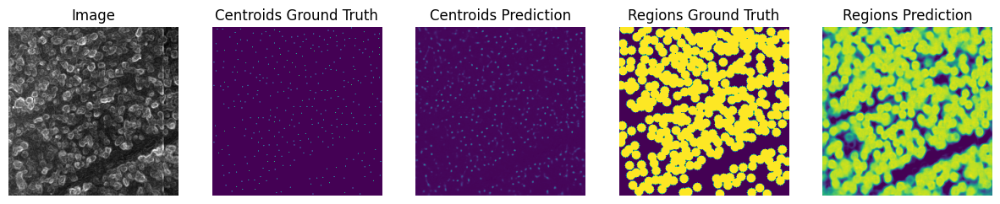

sample  30  saved


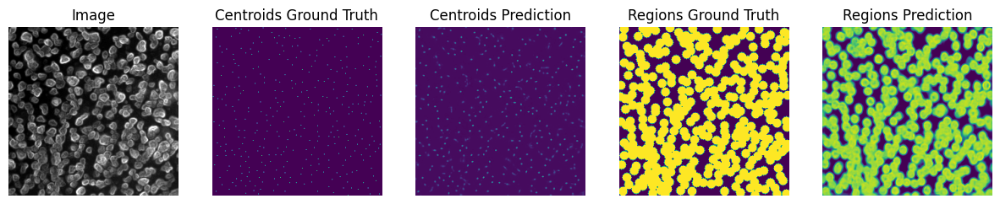

sample  31  saved


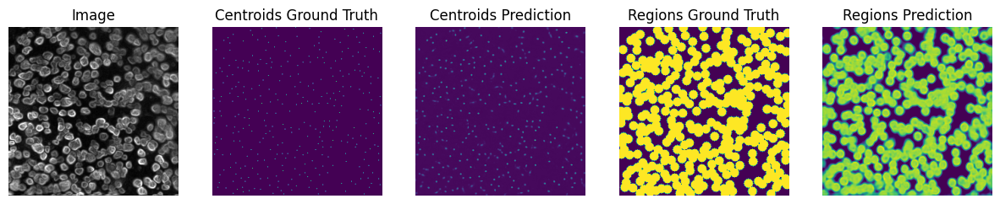

sample  32  saved


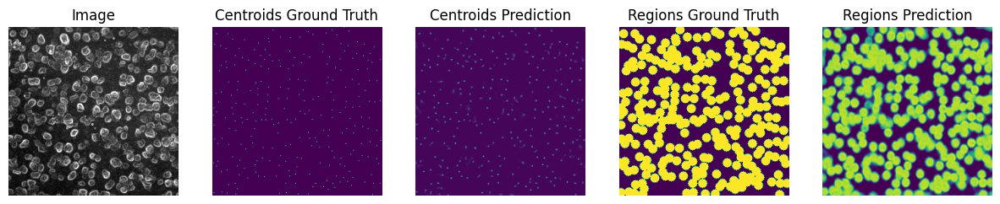

sample  33  saved


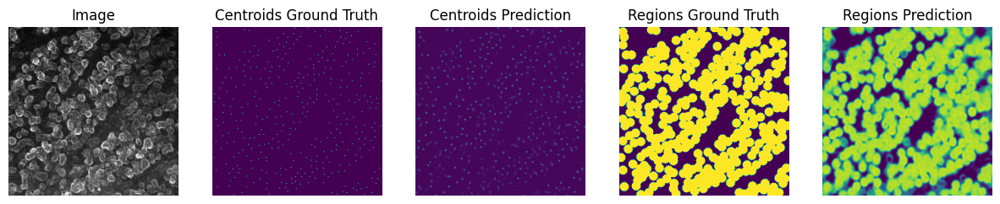

sample  34  saved


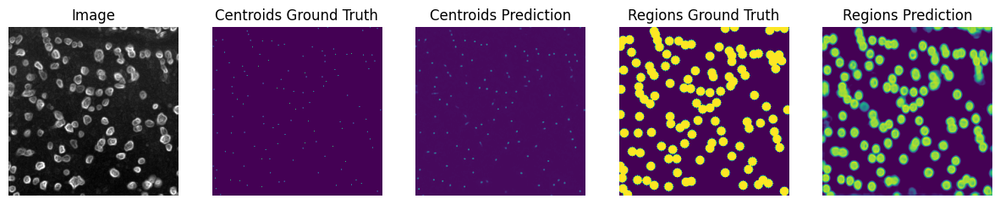

sample  35  saved


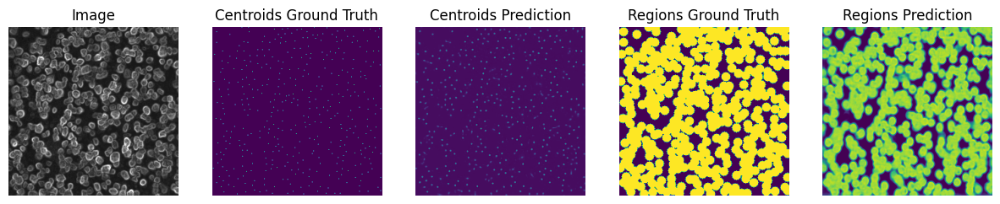

sample  36  saved


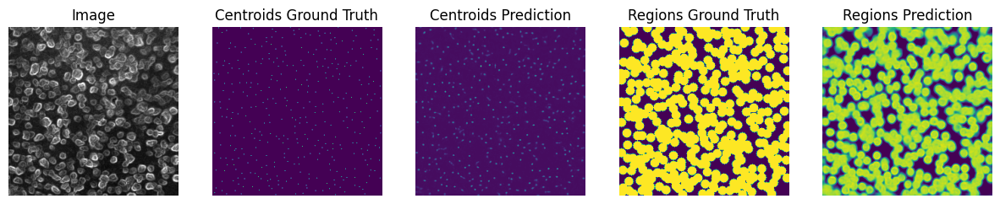

sample  37  saved


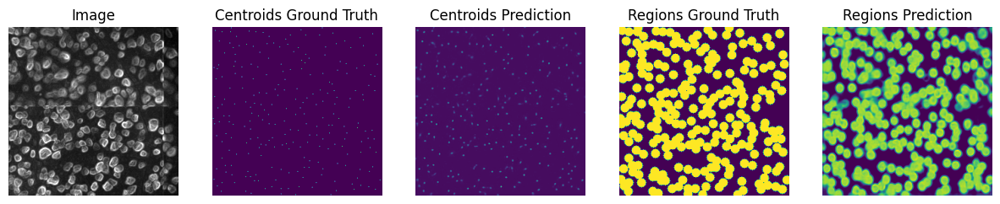

sample  38  saved


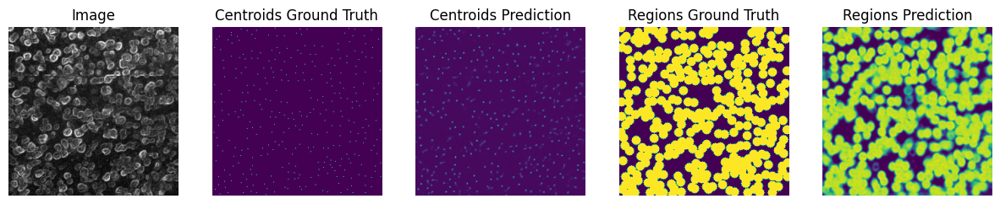

sample  39  saved


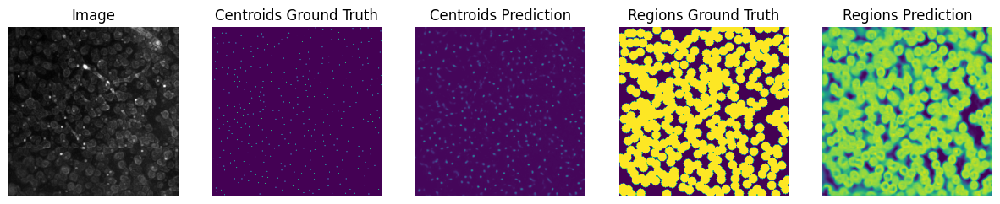

sample  40  saved


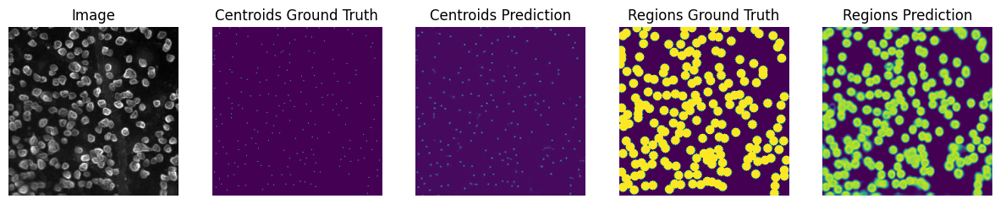

sample  41  saved


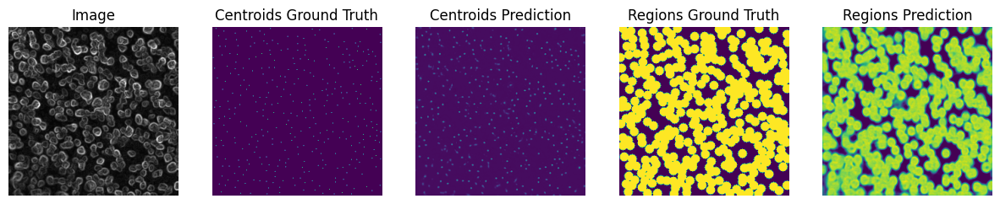

sample  42  saved


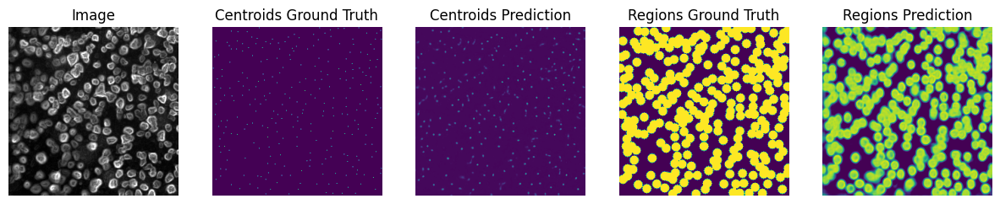

sample  43  saved


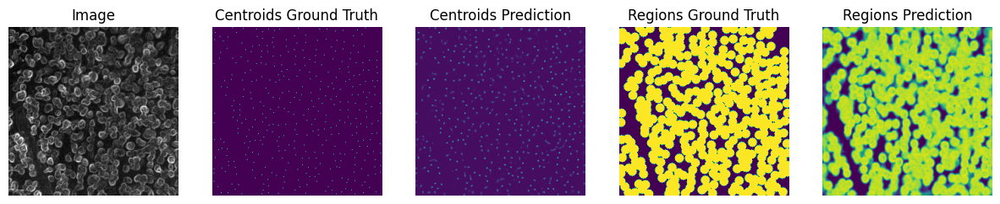

sample  44  saved


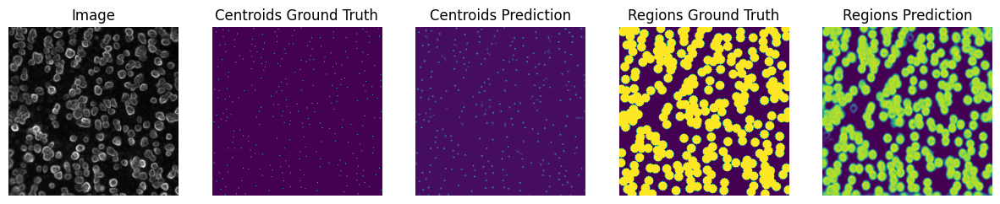

sample  45  saved


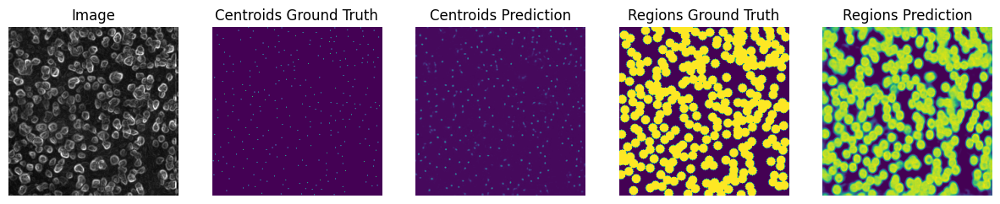

sample  46  saved


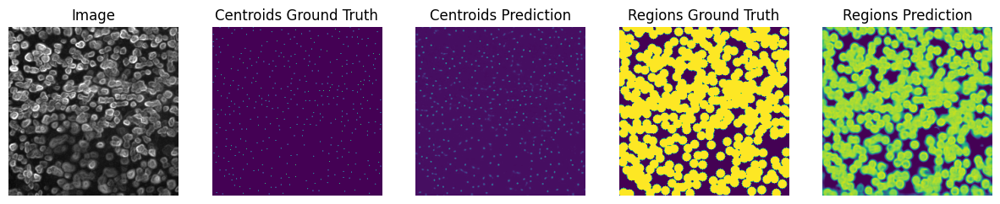

sample  47  saved


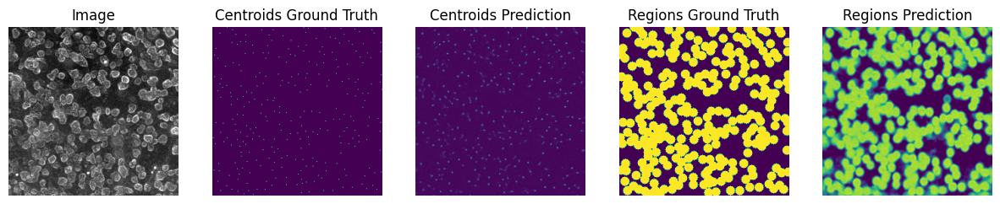

sample  48  saved


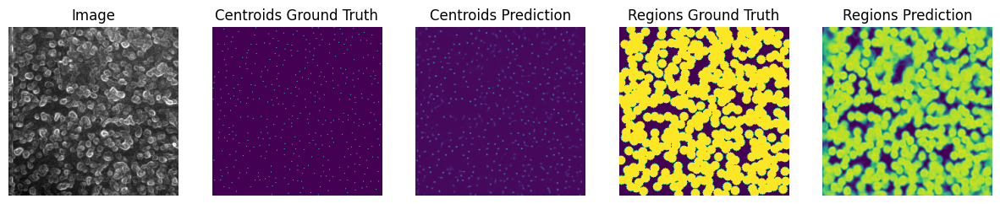

sample  49  saved


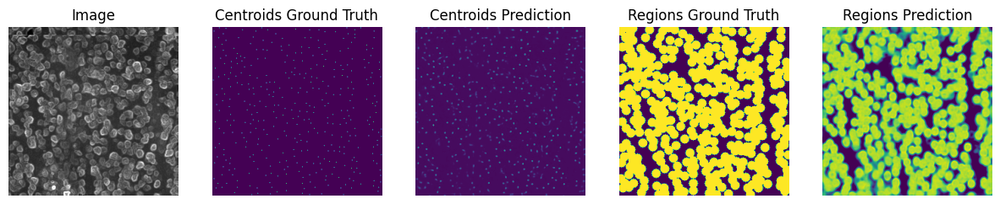

sample  50  saved


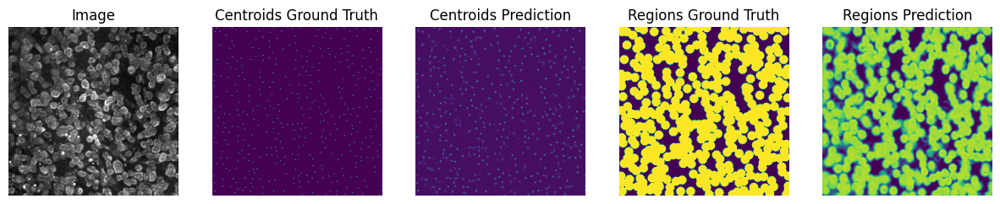

sample  51  saved


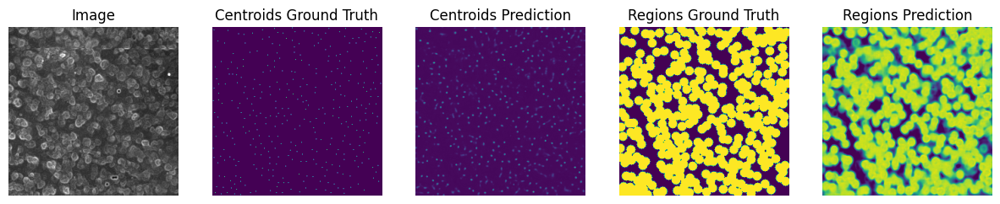

sample  52  saved


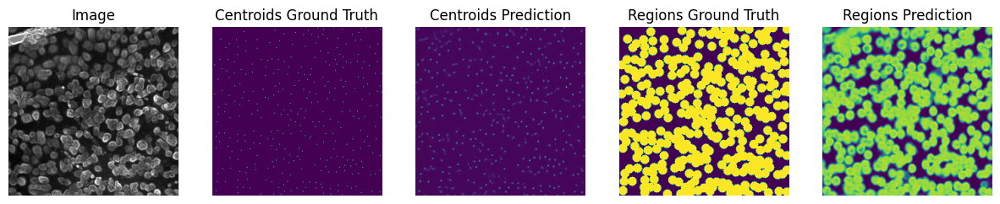

sample  53  saved


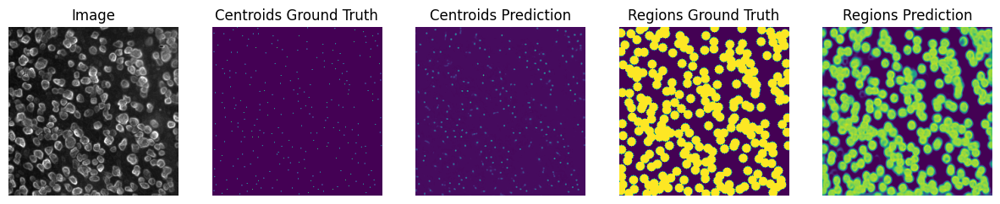

sample  54  saved


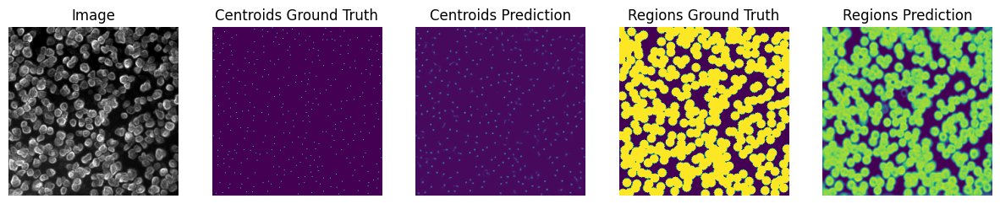

sample  55  saved


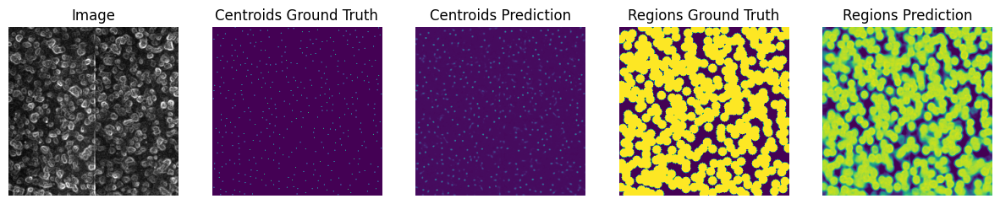

sample  56  saved


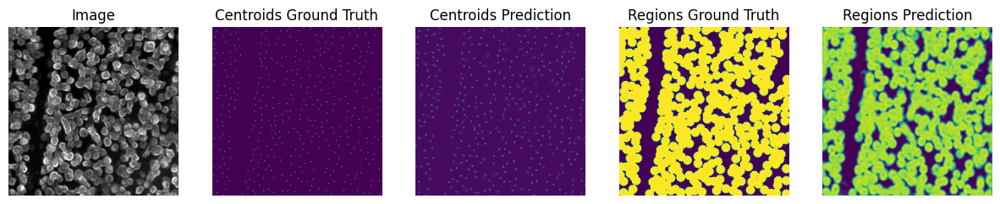

sample  57  saved


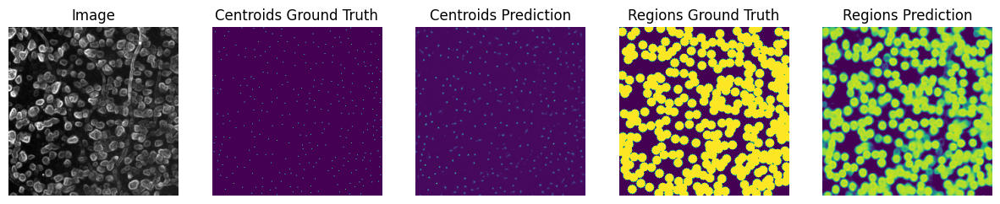

sample  58  saved


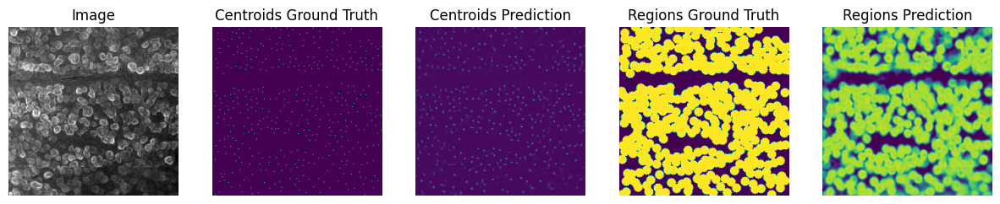

sample  59  saved


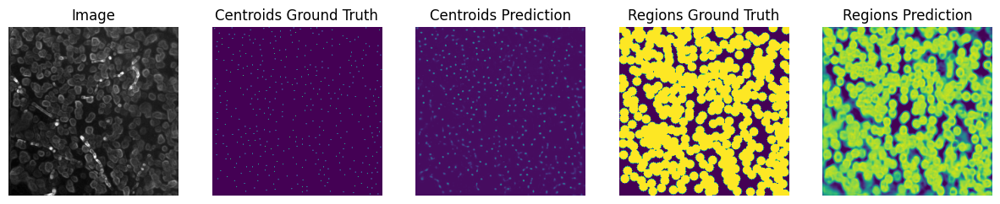

sample  60  saved


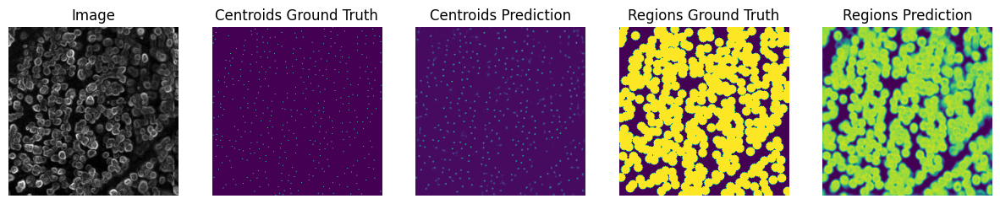

sample  61  saved


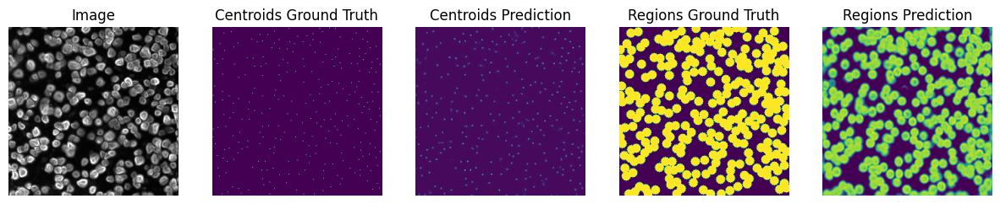

sample  62  saved


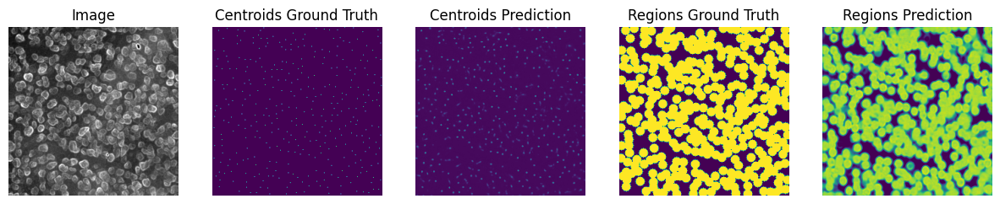

sample  63  saved


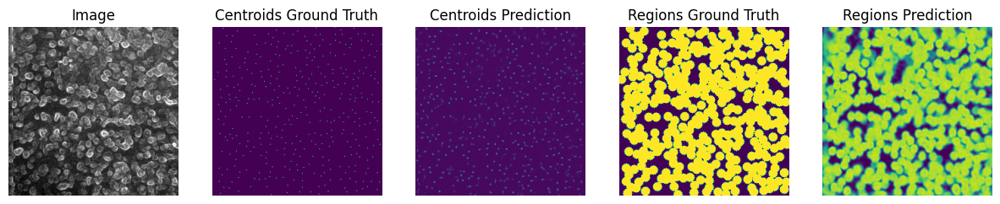

sample  64  saved


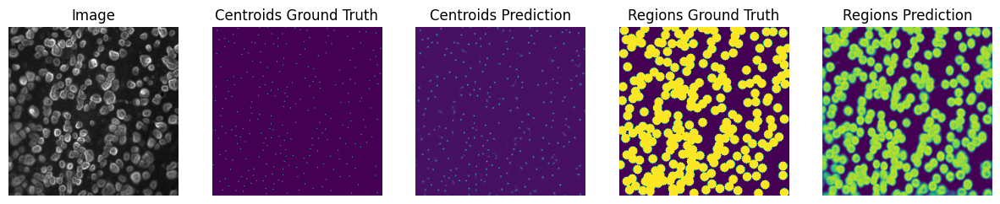

sample  65  saved


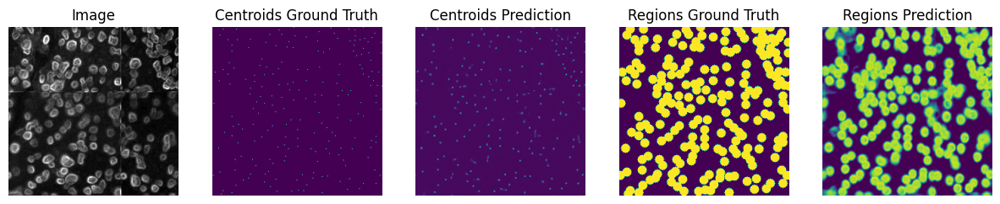

sample  66  saved


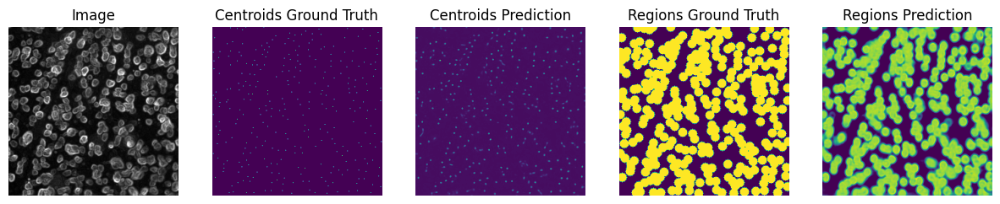

sample  67  saved


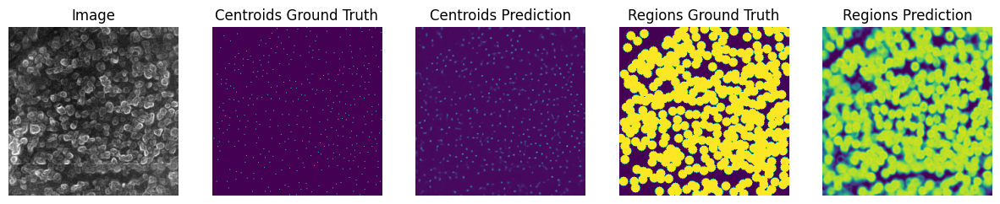

sample  68  saved


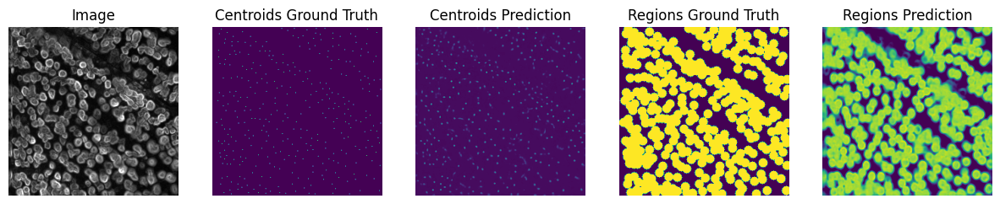

sample  69  saved


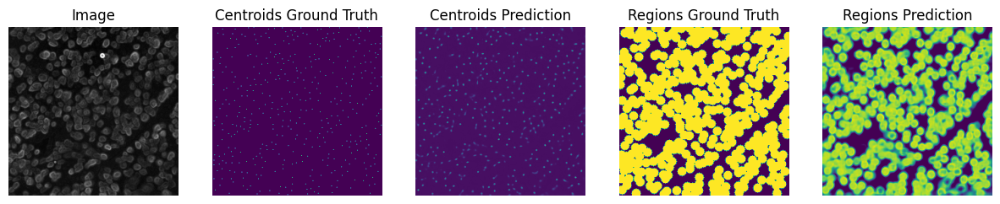

sample  70  saved


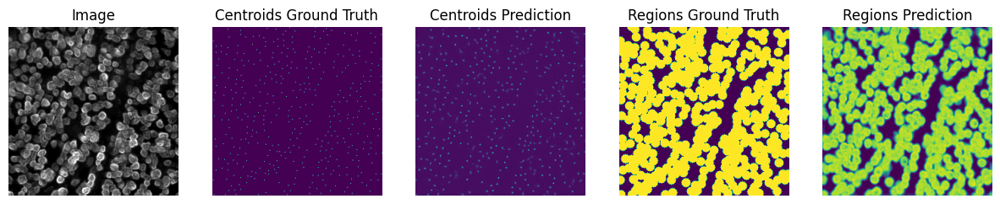

sample  71  saved


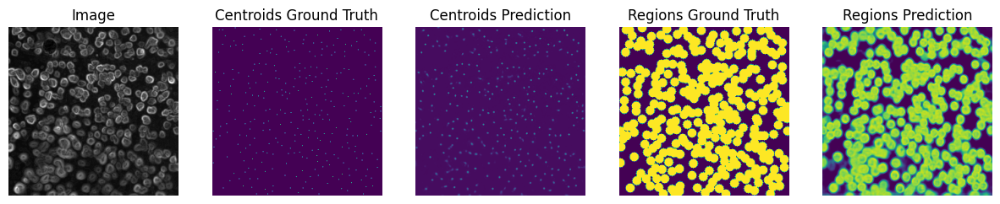

sample  72  saved


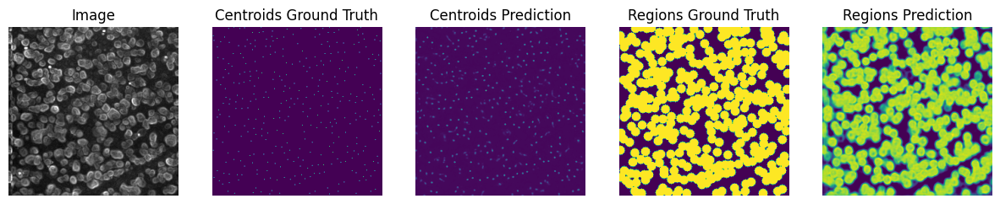

sample  73  saved


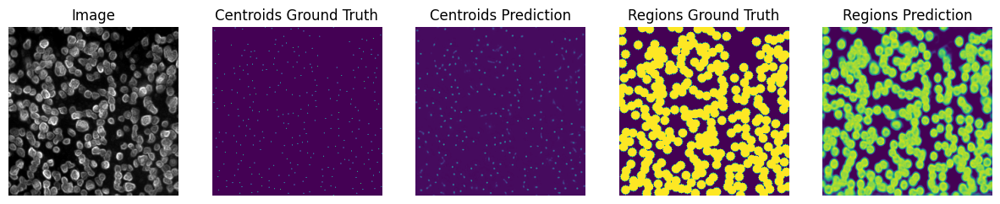

sample  74  saved


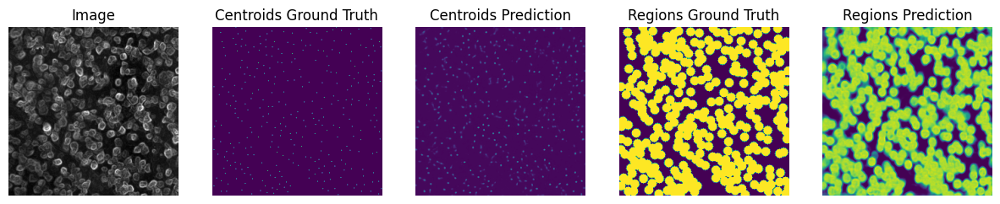

sample  75  saved


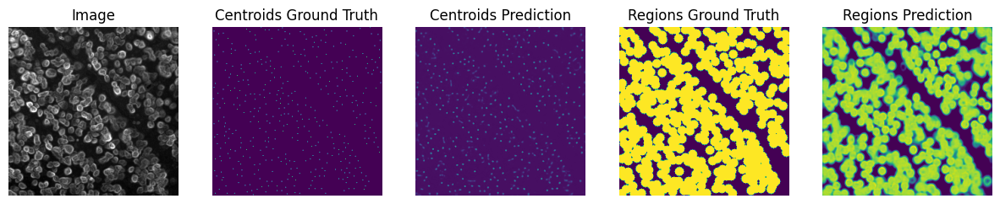

sample  76  saved


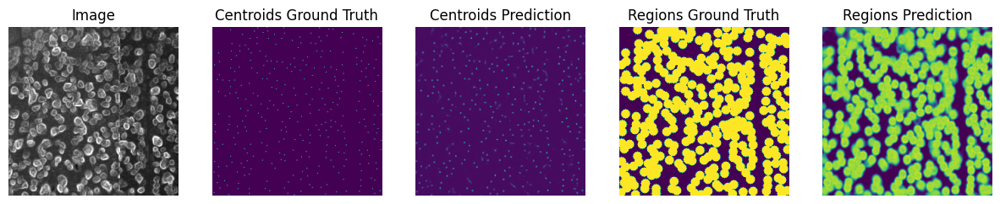

sample  77  saved


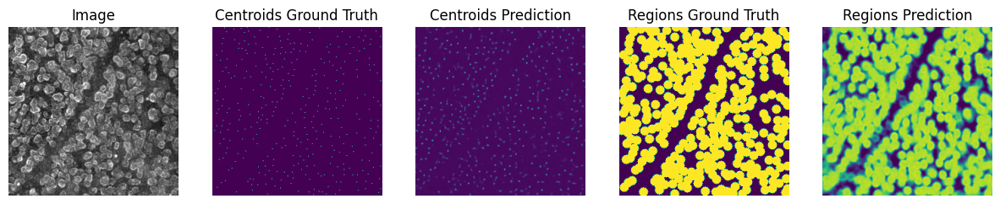

sample  78  saved


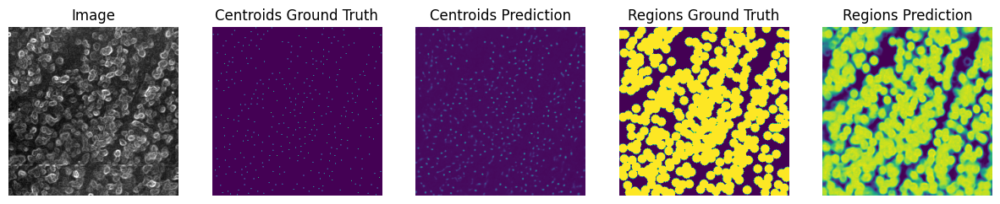

sample  79  saved


In [145]:
# model_regions = buildModel_U_net(input_dim = (256,256,3))
# model_center = buildModel_U_net(input_dim = (256,256,3))
# model_regions.load_weights('./checkpoints_yeast/own_net_regions_50.hdf5')
# model_center.load_weights('./checkpoints_yeast/own_net_center.hdf5')

A = model_regions.predict(data_)

B = model_center.predict(data_)



# data_r_anno_reshaped = np.transpose(r_anno, (0, 2, 3, 1))
# print(data_.shape , r_anno.shape , data_r_anno_reshaped.shape ,  A.shape)

folder_name= base_address+ '/real_dataset/outputs_light_u_net/'
for i in range(data_.shape[0]):
    show_save_all_sample(data_[i] , B[i], anno_centroids[i] , A[i],anno_regions[i]  , folder_name , region_file_names[i] ,counts[i] )
    print("sample ", i , " saved")

# using the best checkpoints on synth dataset

In [164]:
input_image_folder= base_address+ '/synth_dataset/dics/'

label_center_folder= base_address+ '/synth_dataset/dots/'

In [165]:
data, anno_centroids , counts , centroids_file_names = load_images_from_folder(input_image_folder , label_center_folder , "center")
print(f'Loaded {len(data)} cell images and  {len(anno_centroids)} regions label images.')

Loaded 32 cell images and  32 regions label images.


In [161]:
input_image_folder=base_address+ '/synth_dataset/dics/'

label_region_folder=base_address+ '/synth_dataset/regions/'

In [162]:
data, anno_regions  ,region_file_names = load_images_from_folder(input_image_folder , label_region_folder , "region")
print(f'Loaded {len(data)} cell images and  {len(anno_regions)} regions label images.')


Loaded 32 cell images and  32 regions label images.


In [166]:
mean = np.mean(data)
std = np.std(data)

data_ = (data - mean) / std
Length = int(len(data)*0.85)
print("train set size : ",Length , " test set size : " , len(data) - Length)


train set size :  27  test set size :  5


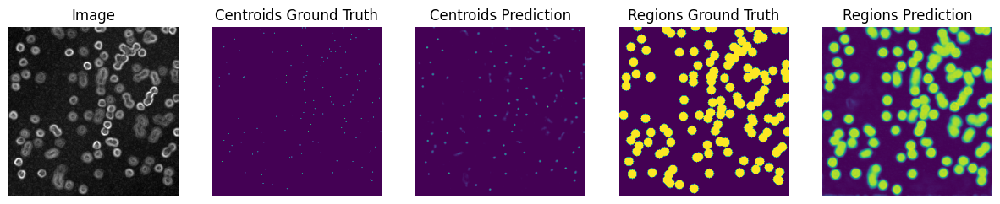

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/001_/
sample  0  saved


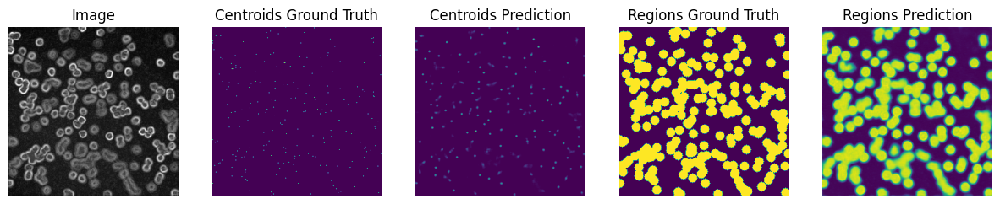

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/002_/
sample  1  saved


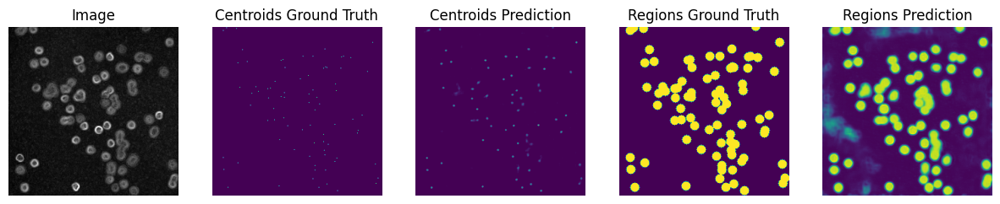

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/003_/
sample  2  saved


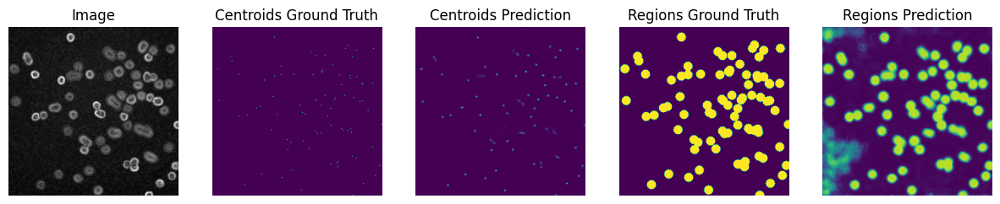

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/004_/
sample  3  saved


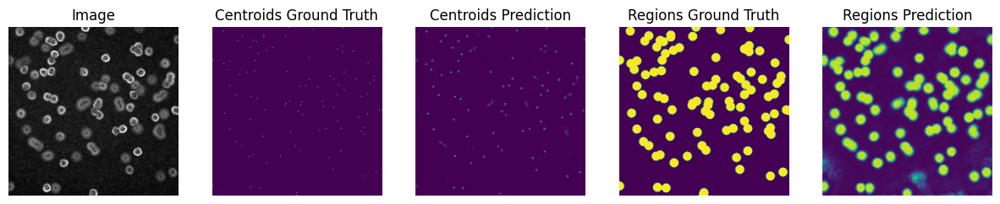

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/005_/
sample  4  saved


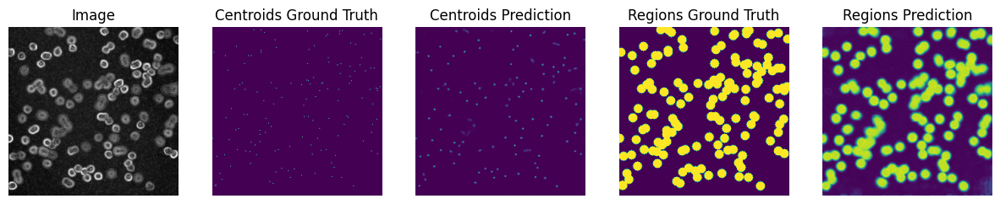

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/006_/
sample  5  saved


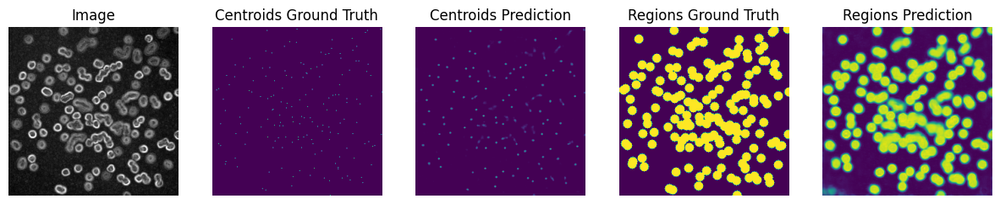

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/007_/
sample  6  saved


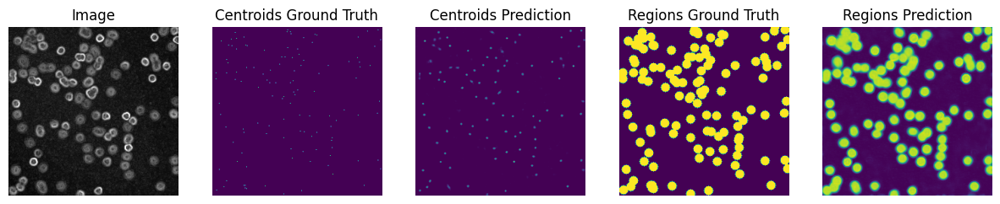

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/008_/
sample  7  saved


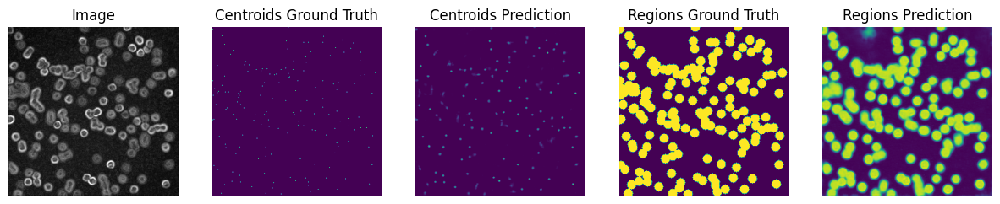

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/009_/
sample  8  saved


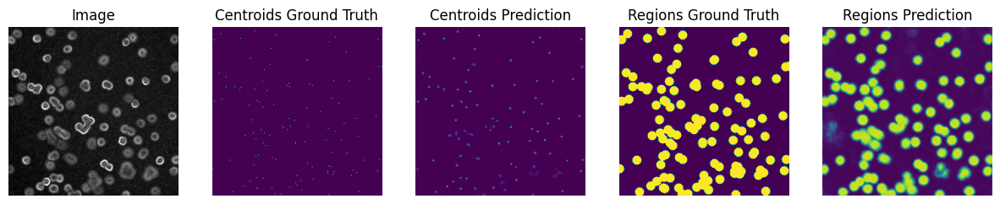

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/010_/
sample  9  saved


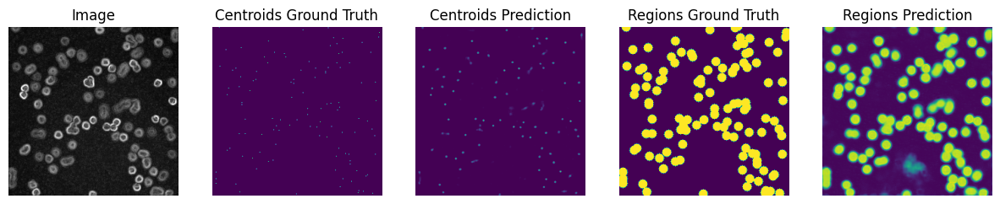

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/011_/
sample  10  saved


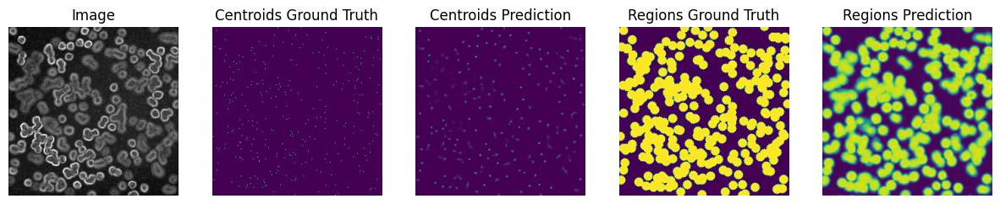

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/012_/
sample  11  saved


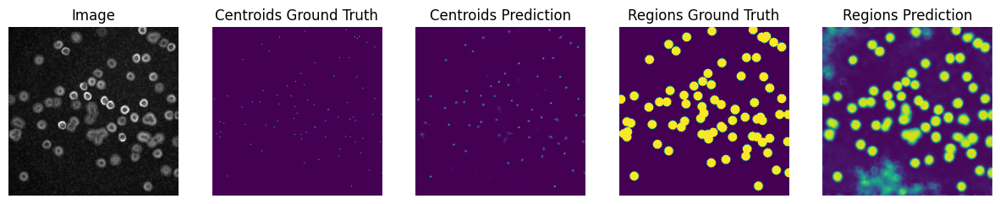

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/013_/
sample  12  saved


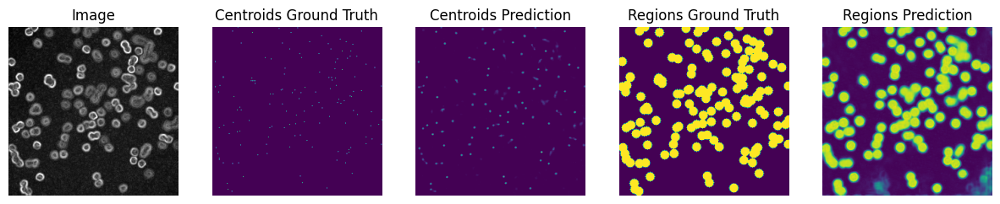

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/014_/
sample  13  saved


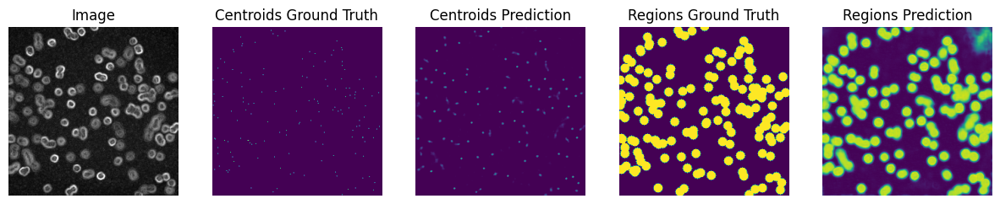

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/015_/
sample  14  saved


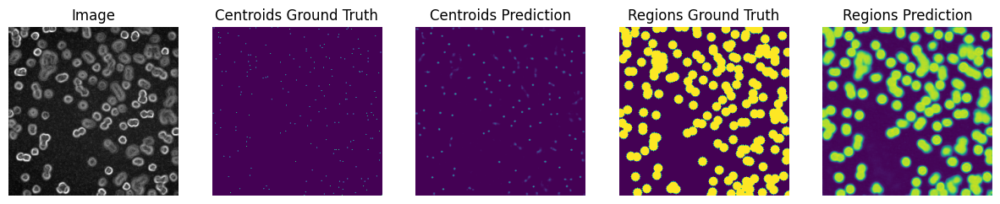

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/016_/
sample  15  saved


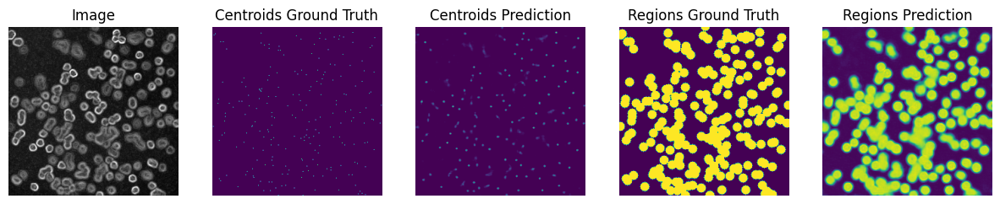

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/017_/
sample  16  saved


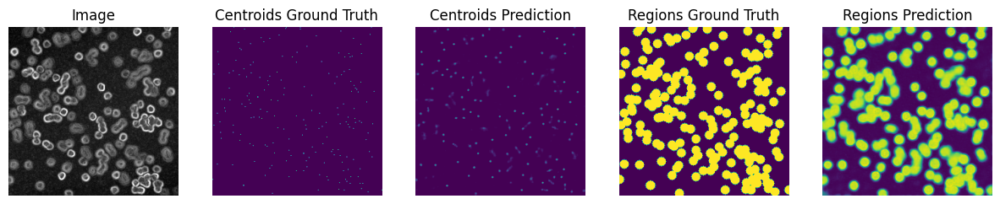

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/018_/
sample  17  saved


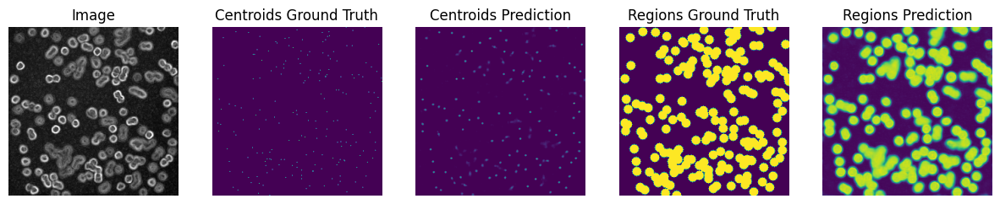

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/019_/
sample  18  saved


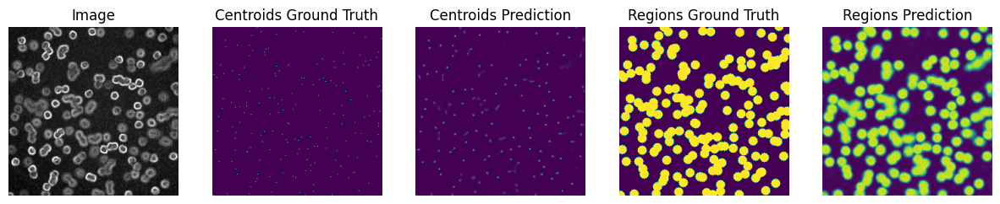

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/020_/
sample  19  saved


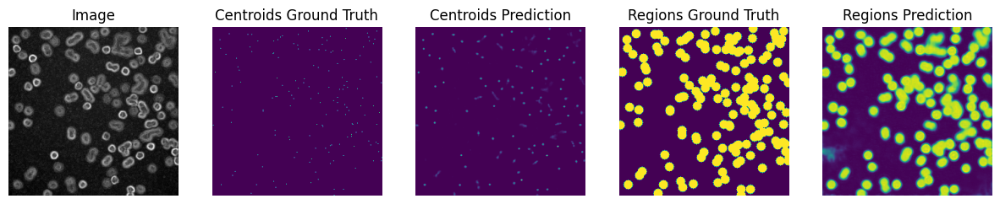

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/021_/
sample  20  saved


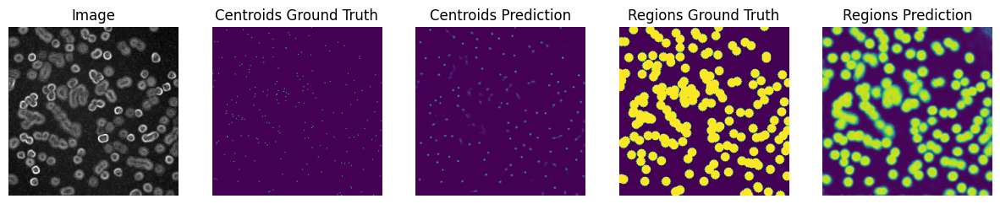

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/022_/
sample  21  saved


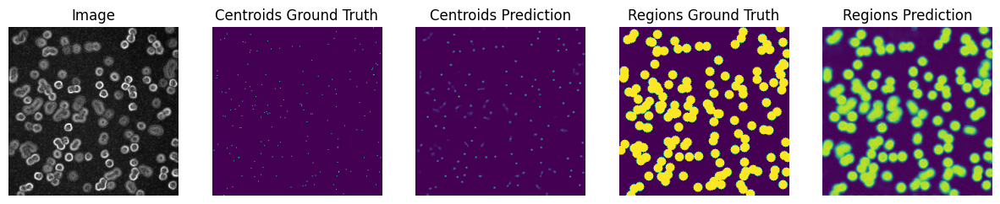

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/023_/
sample  22  saved


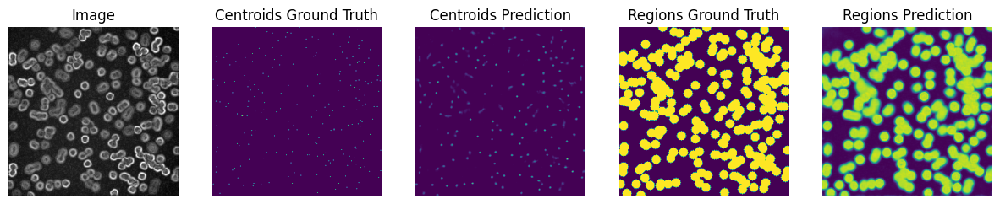

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/024_/
sample  23  saved


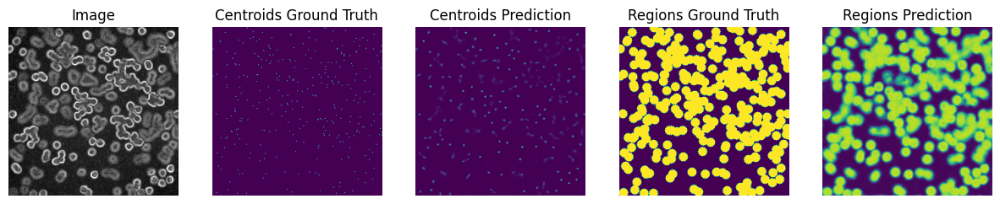

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/025_/
sample  24  saved


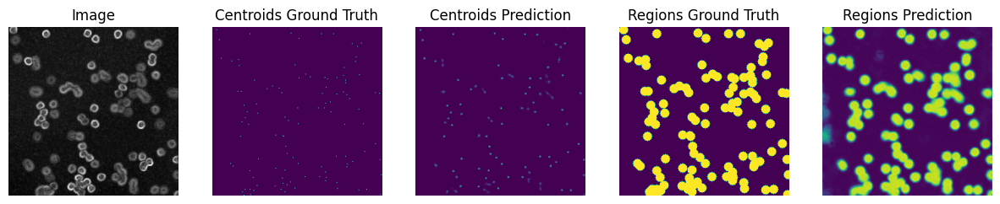

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/026_/
sample  25  saved


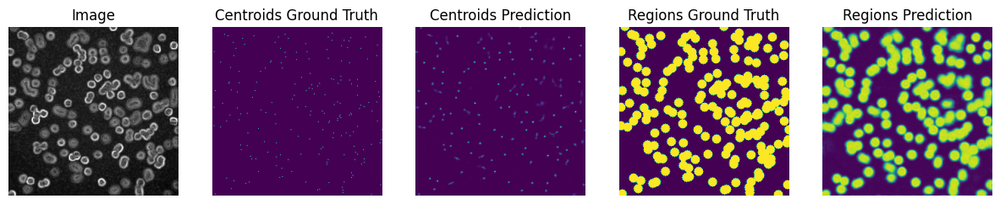

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/027_/
sample  26  saved


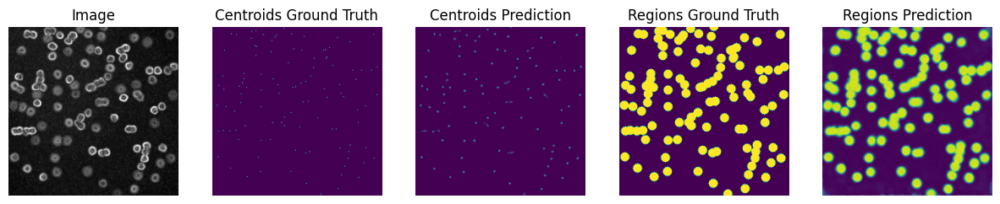

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/028_/
sample  27  saved


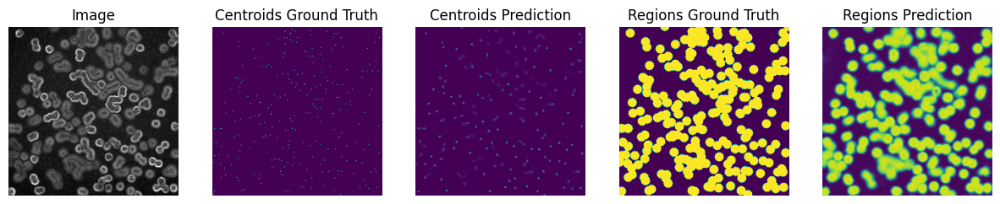

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/029_/
sample  28  saved


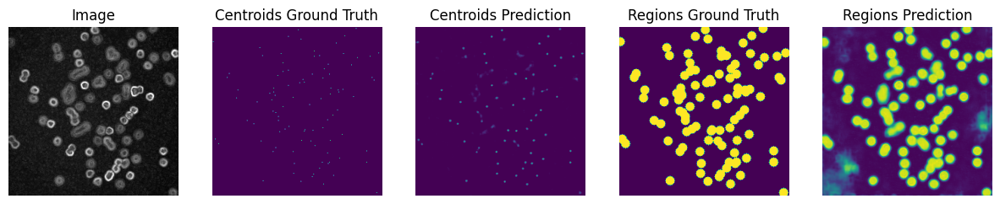

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/030_/
sample  29  saved


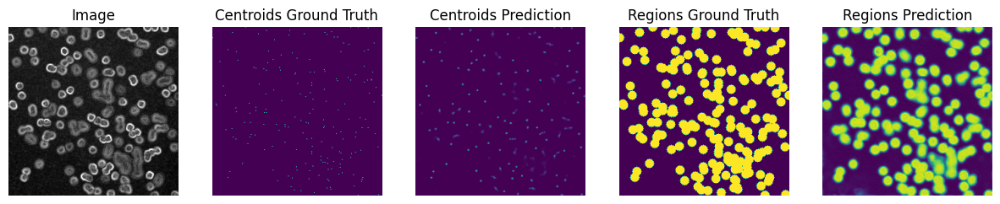

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/031_/
sample  30  saved


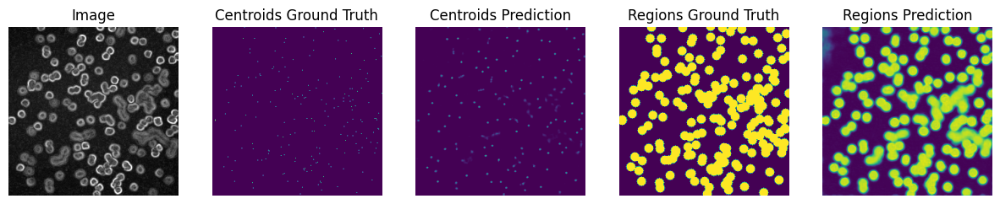

C:/Users/narges/PycharmProjects3/pythonProject3/IEEE_transaction_paper/synth_dataset/outputs_light_u_net1/032_/
sample  31  saved


In [167]:
model_regions1 = buildModel_U_net(input_dim = (256,256,3))
model_center1 = buildModel_U_net(input_dim = (256,256,3))
model_regions1.load_weights(base_address + '/checkpoints/own_net_regions_50.hdf5')
model_center1.load_weights(base_address+'/checkpoints/own_net_center.hdf5')

A = model_regions1.predict(data_)

B = model_center1.predict(data_)



# data_r_anno_reshaped = np.transpose(r_anno, (0, 2, 3, 1))
# print(data_.shape , r_anno.shape , data_r_anno_reshaped.shape ,  A.shape)

folder_name= base_address+ '/synth_dataset/outputs_light_u_net1/'
for i in range(data_.shape[0]):
    show_save_all_sample(data_[i] , B[i], anno_centroids[i] , A[i],anno_regions[i]  , folder_name , region_file_names[i] ,counts[i] )
    print("sample ", i , " saved")